In [1]:
%%javascript
IPython.OutputArea.prototype._should_scroll = function(lines) {
    return false;
}

<IPython.core.display.Javascript object>

# Analysing the World Happyness Report 2019
You can download the data from: https://worldhappiness.report/ed/2019/

## Using pandas
https://pandas.pydata.org/

In [2]:
# Korrelationen anschauen
# Life Leader nach Ländern grupieren
# Nach Jahr änderung zeigen
# Ausreißer zeigen

In [3]:
import pandas as pd
import numpy as np
import matplotlib.pyplot as plt

## Import the dataset
Use a local copy if you update the data on a regular basis

In [4]:
pd.set_option('display.max_columns', None)

df_original = pd.read_excel('./Chapter2OnlineData.xls')

df_original.describe()

# df has 25 Columns

,Year,Life Ladder,Log GDP per capita,Social support,Healthy life expectancy at birth,Freedom to make life choices,Generosity,Perceptions of corruption,Positive affect,Negative affect,Confidence in national government,Democratic Quality,Delivery Quality,Standard deviation of ladder by country-year,Standard deviation/Mean of ladder by country-year,GINI index (World Bank estimate),"GINI index (World Bank estimate), average 2000-16","gini of household income reported in Gallup, by wp5-year","Most people can be trusted, Gallup","Most people can be trusted, WVS round 1981-1984","Most people can be trusted, WVS round 1989-1993","Most people can be trusted, WVS round 1994-1998","Most people can be trusted, WVS round 1999-2004","Most people can be trusted, WVS round 2005-2009","Most people can be trusted, WVS round 2010-2014"
count,1704.000000,1704.000000,1676.000000,1691.000000,1676.000000,1675.000000,1622.000000,1608.000000,1685.000000,1691.000000,1530.000000,1558.000000,1559.000000,1704.000000,1704.000000,643.000000,1502.000000,1335.000000,180.000000,125.000000,220.000000,618.000000,491.000000,630.000000,671.000000
mean,2012.332160,5.437155,9.222456,0.810570,63.111971,0.733829,0.000079,0.751315,0.709368,0.265679,0.481973,-0.136053,-0.001390,2.026707,0.392121,0.370000,0.385438,0.447771,0.226295,0.390480,0.283925,0.249574,0.268070,0.264336,0.237493
std,3.688072,1.121149,1.185794,0.119210,7.583622,0.144115,0.163365,0.186074,0.107984,0.084707,0.192059,0.876074,0.975849,0.401484,0.124661,0.083232,0.082396,0.108505,0.119079,0.123309,0.113226,0.118126,0.145120,0.160169,0.157482
min,2005.000000,2.661718,6.457201,0.290184,32.299999,0.257534,-0.336385,0.035198,0.362498,0.083426,0.068769,-2.448228,-2.144974,0.863034,0.133908,0.240000,0.211000,0.200969,0.066618,0.176535,0.066020,0.048720,0.075872,0.038242,0.031518
25%,2009.000000,4.610970,8.304428,0.747512,58.299999,0.638436,-0.115534,0.696083,0.621855,0.205414,0.334735,-0.790461,-0.711416,1.743369,0.310139,0.305000,0.321429,0.368424,0.139773,0.290300,0.223553,0.176876,0.155833,0.144976,0.118725
50%,2012.000000,5.339557,9.406206,0.833098,65.000000,0.752731,-0.022080,0.805775,0.718541,0.254544,0.464109,-0.227386,-0.218633,1.973070,0.372744,0.352000,0.371000,0.426541,0.198450,0.380174,0.292383,0.229924,0.232000,0.198380,0.193531
75%,2015.000000,6.273522,10.193060,0.904432,68.300003,0.848155,0.093522,0.876458,0.801530,0.314896,0.614862,0.650468,0.699971,2.242300,0.456311,0.428000,0.432200,0.514803,0.281627,0.478149,0.341741,0.294242,0.385469,0.391370,0.335000
max,2018.000000,8.018934,11.770276,0.987343,76.800003,0.985178,0.677743,0.983276,0.943621,0.704590,0.993604,1.575009,2.184725,3.718958,1.022769,0.634000,0.626000,0.961435,0.640332,0.571719,0.594595,0.647737,0.637185,0.737305,0.661757


In [5]:
df_original.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 1704 entries, 0 to 1703
Data columns (total 26 columns):
 #   Column                                                    Non-Null Count  Dtype  
---  ------                                                    --------------  -----  
 0   Country name                                              1704 non-null   object 
 1   Year                                                      1704 non-null   int64  
 2   Life Ladder                                               1704 non-null   float64
 3   Log GDP per capita                                        1676 non-null   float64
 4   Social support                                            1691 non-null   float64
 5   Healthy life expectancy at birth                          1676 non-null   float64
 6   Freedom to make life choices                              1675 non-null   float64
 7   Generosity                                                1622 non-null   float64
 8   Perceptions of cor

## Modify and add to the dataset

In [6]:
# Remove of data with many null values
df = df_original.dropna(thresh=len(df_original)/2, axis=1)

# Log GDP per capital --> Undo the log
exp = 10**(df["Log GDP per capita"])
df["GDP per capita"] = exp
df = df.drop(["Log GDP per capita"], 1)

# Used to subset the data in parts
df_excluded = df.loc[:, df.columns != 'Life Ladder']

ipykernel_launcher:6: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy


In [7]:
# Subset of features
subset1_columns = df_excluded.columns[0:6].tolist()
subset1_columns.insert(0, 'Life Ladder')
subset1 = df[subset1_columns]

subset2_columns = df_excluded.columns[6:12].tolist()
subset2_columns.insert(0, 'Life Ladder')
subset2 = df[subset2_columns]

subset3_columns = df_excluded.columns[12:18].tolist()
subset3_columns.insert(0, 'Life Ladder')
subset3 = df[subset3_columns]

## First Visualisation

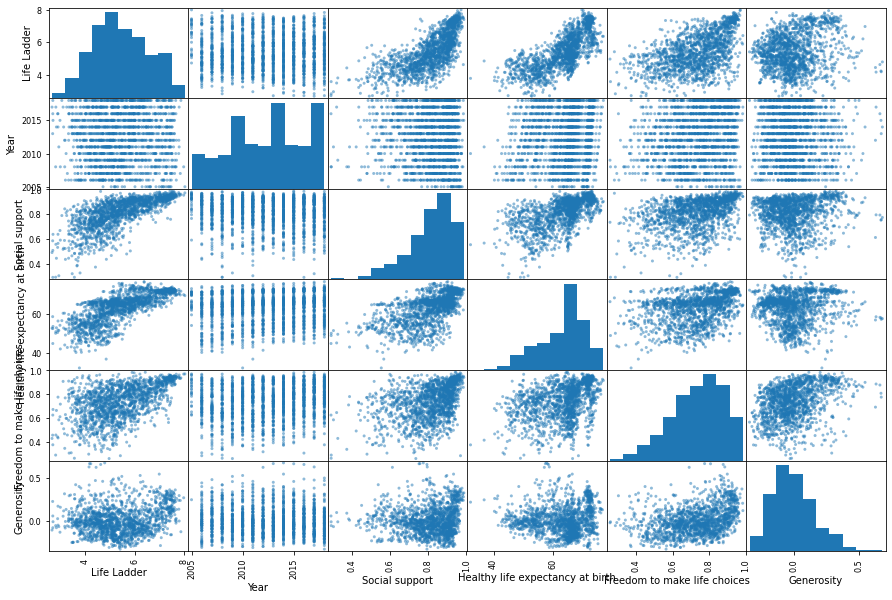

In [8]:

plot1 = pd.plotting.scatter_matrix(subset1, figsize=(15, 10))

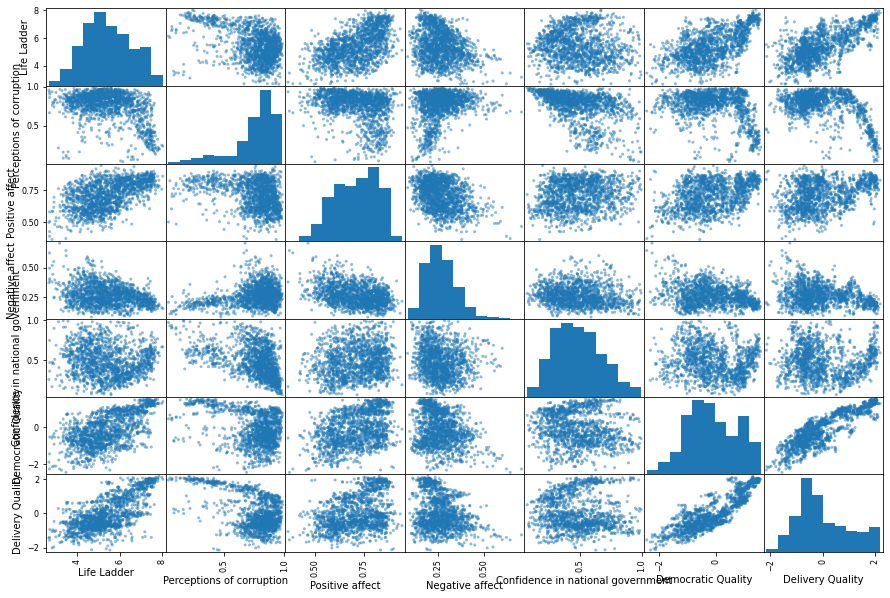

In [9]:
# No visible correlations:
#Genorisity, Negative effect, confidence in national government
plot2 = pd.plotting.scatter_matrix(subset2, figsize=(15, 10))

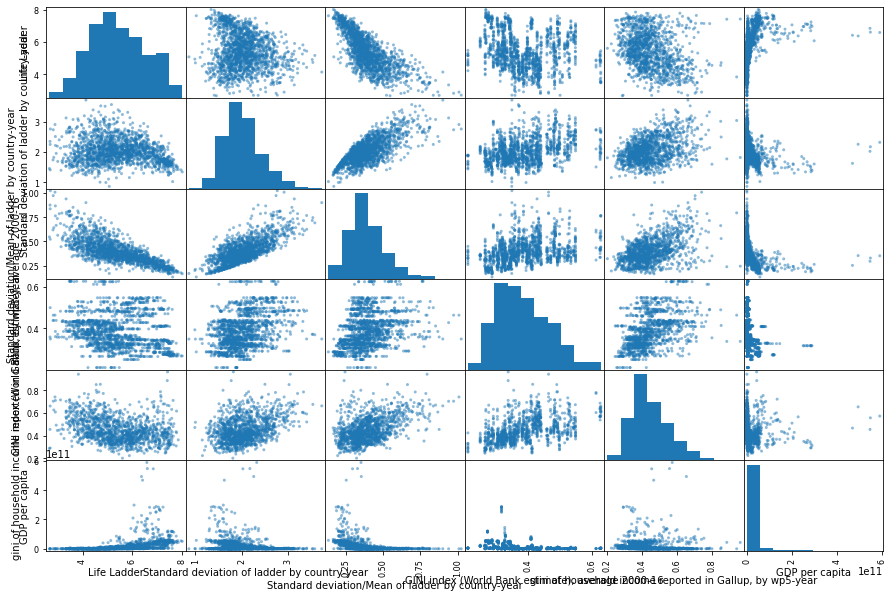

In [10]:
# No visible correlations:
#Standard deviation of ladder by country-year, 
plot3 = pd.plotting.scatter_matrix(subset3, figsize=(15, 10))

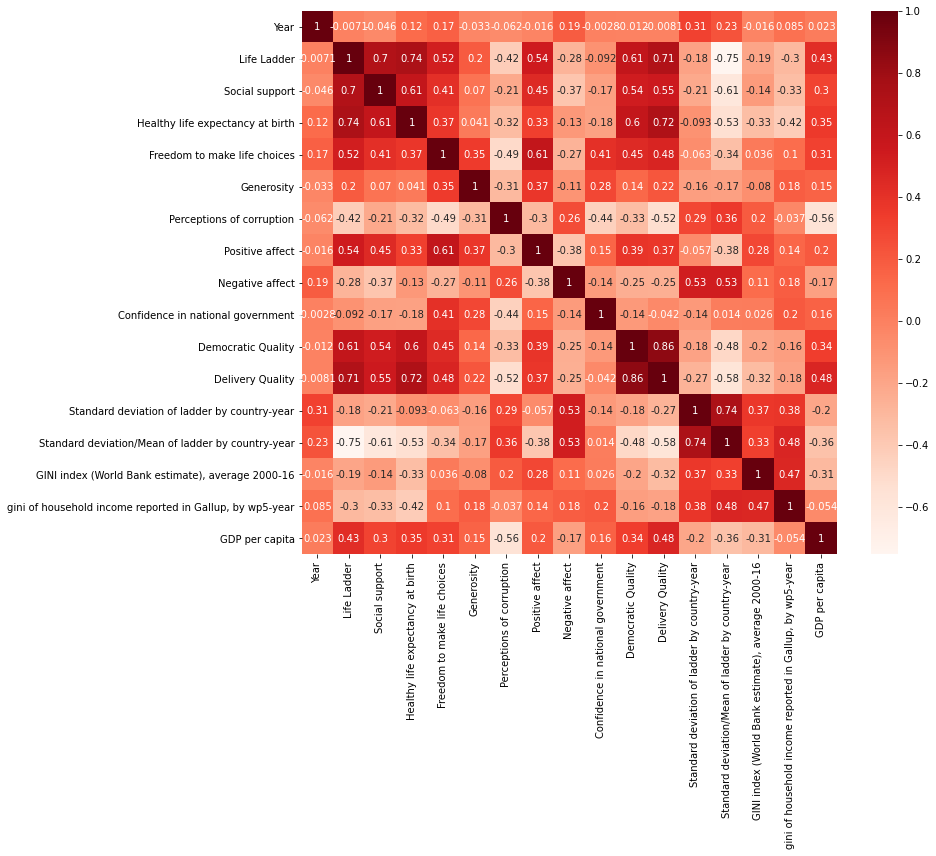

In [11]:
import seaborn as sns

corr = df.corr()
plt.figure(figsize=(12,10))
sns.heatmap(corr, annot=True, cmap=plt.cm.Reds)
plt.show()

## Aggregating data, calculate additional data

In [12]:
### Dismiss countries with < 6 occurrences ###
print('Countries with 5 or less values will be dismissed')
validCount = sum(1 for value in df['Country name'].value_counts().values if value > 5)
countries_remove = df['Country name'].value_counts().index[validCount:]

#df.loc[df['Country name'] == 'Sudan']

remove_mask = df['Country name'].isin(countries_remove)

df = df[~remove_mask]

countries =df['Country name'].unique()

# Last Life Ladder (LL) of country
countries_data_LL = {}
# Differenze of first & Last Life Ladder Value (absolute)
countries_diff_LL = {}
# Differenze of first & Last Life Ladder Value (relative)
countries_diff_rel_LL = {}
diff = None
for country in countries:
    country_data = df.loc[df['Country name'] == country]
    first_el = country_data['Life Ladder'].iloc[0]
    last_el = country_data['Life Ladder'].iloc[-1]
    diff = last_el - first_el

    if first_el <= 0:
        raise ValueError("Only positive Life Ladder values are valid for this analysis")

    countries_data_LL[country] = country_data
    countries_diff_LL[country] = diff
    countries_diff_rel_LL[country] = diff / first_el # relative to LL first value

max_key = max(countries_diff_LL, key=countries_diff_LL.get)
min_key = min(countries_diff_LL, key=countries_diff_LL.get)

#print(list(countries_data_LL.values())[1])

### Mean Life Ladder of each Country per year ###

mean = df.groupby('Year')['Life Ladder'].mean()
mean_years = mean.index
mean_values = mean.values


Countries with 5 or less values will be dismissed


In [13]:
# Old Code to determine maximum correlated of Life Ladder to Year for each country

#corr_by_country = {}
#for country in countries:
#    corr = df.loc[df['Country name'] == country].corr()['Year']['Life Ladder']
#    corr_by_country[country] = corr

#max_key = max(corr_by_country, key=corr_by_country.get)
#min_key = min(corr_by_country, key=corr_by_country.get)

#print(f'"{max_key}" is the Country with the most positive correlation of Year to Life Ladder.')
#print(f'"{min_key}" is the Country with the most negative correlation of Year to Life Ladder.')

## Polished data visualisation

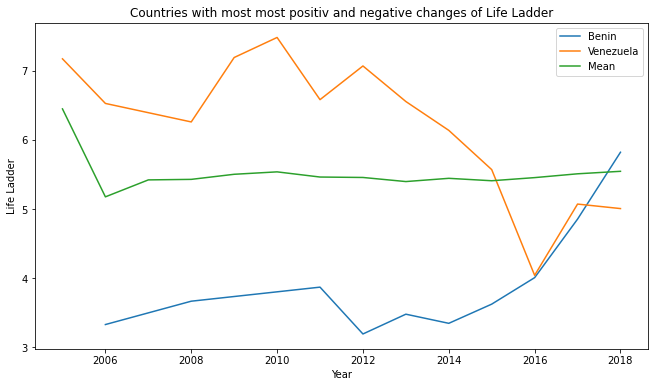

In [14]:
import matplotlib.pyplot as plt

df_maxKey = df.loc[df['Country name'] == max_key]
df_minKey = df.loc[df['Country name'] == min_key]

plt.figure('Figure 1', figsize=(11,6))
plt.plot(df_maxKey['Year'], df_maxKey['Life Ladder'], label=max_key)
plt.plot(df_minKey['Year'], df_minKey['Life Ladder'], label=min_key)
plt.plot(mean_years, mean_values, label="Mean")
plt.title('Countries with most most positiv and negative changes of Life Ladder')
plt.xlabel('Year')
plt.ylabel('Life Ladder')
plt.legend()
plt.show()

## World Map of last Life Ladder Value of each Country

In [15]:
import geopandas as gpd
shapefile = 'MapData/ne_110m_admin_0_countries.shp'
#Read shapefile using Geopandas
gdf = gpd.read_file(shapefile)[['ADMIN', 'ADM0_A3', 'geometry']]
#Rename columns.
gdf.columns = ['country', 'country_code', 'geometry']
gdf.head()

ModuleNotFoundError: No module named 'geopandas'